Final Project  -- mobile net attempt

Chest Xray classification

Tasks   1. load data
        2. No separation of lobes: Not done on this as mobilenet needs 224x224x3
        3. data augmentatiom
        4. Select a transfer learning network
        5. augment last classification
        6. run model
        7. analysis PCA
        

importing data and labels.  folder name is the label

In [9]:
# Load modules and data
import os

import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator

DATA_LIST = os.listdir('/Users/diana/Documents/SUMMER2022/final-project-DeDe-Sunshine/all/old_train')
DATASET_PATH  = '/Users/diana/Documents/SUMMER2022/final-project-DeDe-Sunshine/all/old_train'
TEST_DIR =  '/Users/diana/Documents/SUMMER2022/final-project-DeDe-Sunshine/all/old_test'
IMAGE_SIZE    = (224, 224)
NUM_CLASSES   = len(DATA_LIST)
BATCH_SIZE    = 10  
NUM_EPOCHS    = 100
LEARNING_RATE = 0.001 

In [10]:
# function to display images 
def process(filename: str=None) -> None:
    """
    View multiple images stored in files, stacking vertically

    Arguments:
        filename: str - path to filename containing image
    """
    
    image = mpimg.imread(filename)
    
    plt.figure()
    plt.imshow(image)

/var/folders/2g/c1g3z17d3c914h50f_sxqw5m0000gp/T/ipykernel_21446/1019666265.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


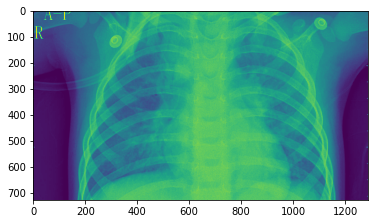

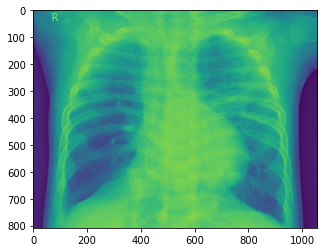

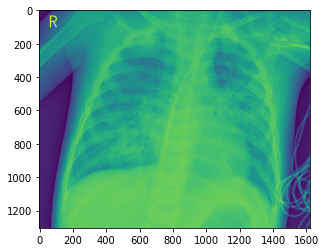

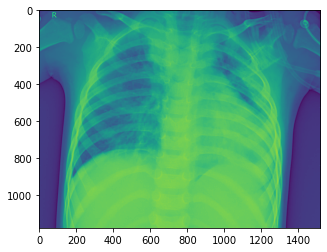

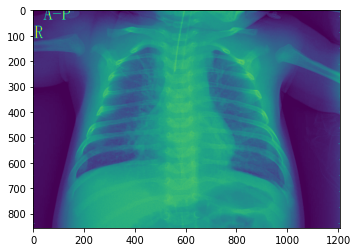

...

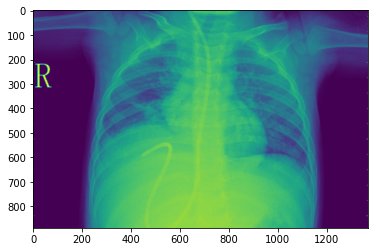

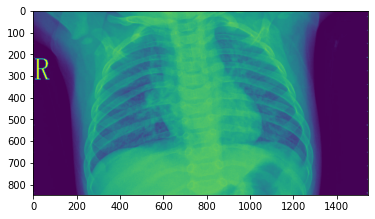

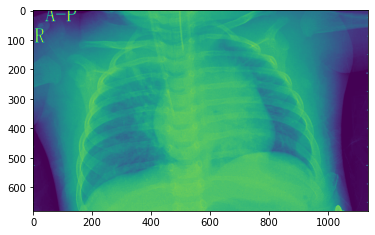

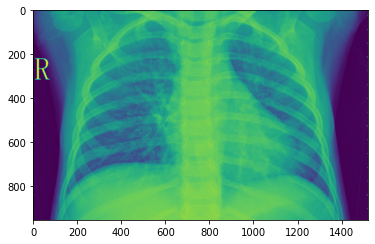

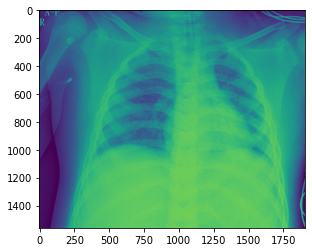

In [11]:
# visualizing images 
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
images = []
folders = []

[folders.append(item) for item in DATA_LIST]
for folder in folders:
    if not folder.startswith('.'):
        images =os.listdir(DATASET_PATH+'/'+folder)
        for file in images:
            if not file.startswith('.'):
                #print(file)
                process(DATASET_PATH+'/'+folder+'/'+file)



In [16]:
# Data Augmentation - sample size is small - 80/20 train/valdiation split 

train_datagen = ImageDataGenerator(rescale=1./255,
                                   rotation_range=50,
                                   #featurewise_center = True,
                                   #featurewise_std_normalization = True,
                                   width_shift_range=0.2,
                                   height_shift_range=0.2,
                                   shear_range=0.25,
                                   zoom_range=0.1,
                                   #zca_whitening = True,
                                   channel_shift_range = 20,
                                   horizontal_flip = True,
                                   vertical_flip = True,
                                   validation_split = 0.2,
                                   fill_mode='constant')
                                
#train_datagen.fit(x_train)
# Training 
train_batches = train_datagen.flow_from_directory(DATASET_PATH,target_size=IMAGE_SIZE,
                                                  shuffle=True,batch_size=BATCH_SIZE,
                                                  subset = "training",seed=42,
                                                  class_mode="categorical")
# Validation split 
valid_batches = train_datagen.flow_from_directory(DATASET_PATH,target_size=IMAGE_SIZE,
                                                  shuffle=True,batch_size=BATCH_SIZE,
                                                  subset = "validation",
                                                  seed=42,class_mode="categorical")

Found 216 images belonging to 4 classes.
Found 54 images belonging to 4 classes.


In [17]:
# show class labels which is folder name
train_batches.class_indices

{'covid': 0, 'normal': 1, 'pneumonia_bac': 2, 'pneumonia_vir': 3}

In [18]:
# Transfer learning - VGG16 
# change last part to output 4 category 
# Dropout utilized to prevent overfitting 
from tensorflow import keras 
from keras.layers import Dropout
from keras import layers
from keras.utils.vis_utils import plot_model
from keras.models import Model
from keras.layers import Dense
from keras.layers import Flatten
from keras.applications.mobilenet_v2 import MobileNetV2

base_model = keras.applications.mobilenet_v2.MobileNetV2(input_shape=None, 
                                                         alpha=1.0, 
                                                         #depth_multiplier=1, 
                                                         include_top=True, 
                                                         weights='imagenet', 
                                                         input_tensor=None, 
                                                         pooling=None, 
                                                         classes=1000)
base_model.trainable = False
inputs = keras.Input(shape=(224, 224, 3))
x = base_model(inputs, training=False)
#x = tf.keras.layers.AveragePooling2D()(x)
x = tf.keras.layers.Flatten()(x)
x = keras.layers.Dense(1024, activation='relu')(x)
x = Dropout(0.75)(x)
x = keras.layers.Dense(1024, activation='relu')(x)
x = Dropout(0.75)(x)
outputs = keras.layers.Dense(4, activation='softmax')(x)
# Note output is Dense 4 because 4 categories 
model = tf.keras.Model(inputs, outputs)

# model summary for visualizing 
model.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_10 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 mobilenetv2_1.00_224 (Funct  (None, 1000)             3538984   
 ional)                                                          
                                                                 
 flatten_2 (Flatten)         (None, 1000)              0         
                                                                 
 dense_6 (Dense)             (None, 1024)              1025024   
                                                                 
 dropout_4 (Dropout)         (None, 1024)              0         
                                                                 
 dense_7 (Dense)             (None, 1024)              1049600   
                                                           

In [19]:
#FIT MODEL
print(len(train_batches))
print(len(valid_batches))

STEP_SIZE_TRAIN=train_batches.n//train_batches.batch_size
STEP_SIZE_VALID=valid_batches.n//valid_batches.batch_size
base_model = keras.applications.ResNet50V2(weights='imagenet', input_shape=(224, 224, 3), include_top=False)
model.compile(
    optimizer=keras.optimizers.Adam(learning_rate=0.0001),
    loss=keras.losses.CategoricalCrossentropy(from_logits=False),
    # List of metrics to monitor
    metrics='Accuracy'
)
cp_callbacks = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    min_delta=0,
    patience=20,
    verbose=1,
    mode='auto',
    baseline=None,
    restore_best_weights=True
)
history = model.fit(train_batches, batch_size=10, epochs=100, validation_data=valid_batches, callbacks = cp_callbacks)

22
6
Epoch 1/100
22/22 [==============================] - 18s 678ms/step - loss: 1.3863 - Accuracy: 0.2917 - val_loss: 1.3851 - val_Accuracy: 0.3148
Epoch 2/100
22/22 [==============================] - 15s 662ms/step - loss: 1.3860 - Accuracy: 0.2917 - val_loss: 1.3846 - val_Accuracy: 0.3519
Epoch 3/100
22/22 [==============================] - 16s 714ms/step - loss: 1.3857 - Accuracy: 0.2824 - val_loss: 1.3824 - val_Accuracy: 0.3889
Epoch 4/100
22/22 [==============================] - 16s 747ms/step - loss: 1.3829 - Accuracy: 0.3056 - val_loss: 1.3811 - val_Accuracy: 0.4074
Epoch 5/100
22/22 [==============================] - 17s 767ms/step - loss: 1.3796 - Accuracy: 0.2917 - val_loss: 1.3804 - val_Accuracy: 0.3704
Epoch 6/100
22/22 [==============================] - 16s 744ms/step - loss: 1.3818 - Accuracy: 0.2824 - val_loss: 1.3757 - val_Accuracy: 0.3333
Epoch 7/100
22/22 [==============================] - 18s 811ms/step - loss: 1.3732 - Accuracy: 0.3426 - val_loss: 1.3754 - val_Accu

22/22 [==============================] - 17s 775ms/step - loss: 1.0864 - Accuracy: 0.5370 - val_loss: 1.1604 - val_Accuracy: 0.4630
Epoch 58/100
22/22 [==============================] - 18s 822ms/step - loss: 1.1579 - Accuracy: 0.5000 - val_loss: 1.1119 - val_Accuracy: 0.4815
Epoch 59/100
22/22 [==============================] - 16s 722ms/step - loss: 1.1586 - Accuracy: 0.4676 - val_loss: 1.1779 - val_Accuracy: 0.4259
Epoch 60/100
22/22 [==============================] - 20s 889ms/step - loss: 1.1465 - Accuracy: 0.5000 - val_loss: 1.0191 - val_Accuracy: 0.5556
Epoch 61/100
22/22 [==============================] - 16s 709ms/step - loss: 1.1815 - Accuracy: 0.4815 - val_loss: 1.0749 - val_Accuracy: 0.4630
Epoch 62/100
22/22 [==============================] - 18s 845ms/step - loss: 1.1936 - Accuracy: 0.4630 - val_loss: 1.0027 - val_Accuracy: 0.4630
Epoch 63/100
22/22 [==============================] - 15s 676ms/step - loss: 1.2229 - Accuracy: 0.4306 - val_loss: 1.1137 - val_Accuracy: 0.481

In [20]:
!mkdir -p saved_model
model.save('saved_model/MobileNet_model')

2022-08-09 08:29:03.956856: W tensorflow/python/util/util.cc:368] Sets are not currently considered sequences, but this may change in the future, so consider avoiding using them.


INFO:tensorflow:Assets written to: saved_model/MobileNet_model/assets


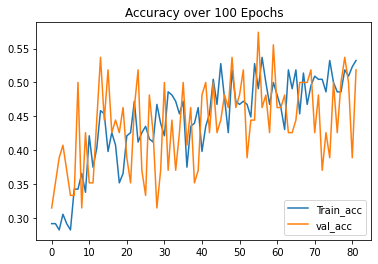

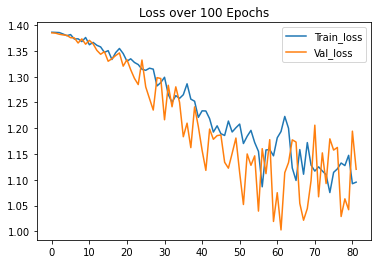

In [21]:
#Graphical output of training progress.  
#Train <= validation so no overfitting
import matplotlib.pyplot as plt


plt.plot(history.history['Accuracy'], label='Train_acc')
plt.plot(history.history['val_Accuracy'], label = 'val_acc')
plt.title('Accuracy over 100 Epochs')
plt.legend(loc='lower right')
plt.show()
plt.plot(history.history['loss'], label='Train_loss')
plt.plot(history.history['val_loss'], label = 'Val_loss')
plt.title('Loss over 100 Epochs')
plt.legend(loc='upper right')
plt.show()

In [30]:
# construct test data 

import os
from tensorflow import keras 
from keras.layers import Dropout
from keras import layers
from keras.utils.vis_utils import plot_model
from keras.models import Model
from keras.layers import Dense
from keras.layers import Flatten
from keras.applications.vgg16 import VGG16

import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator(rescale=1./255)

test_batches = train_datagen.flow_from_directory(TEST_DIR,target_size=IMAGE_SIZE,
                                                  shuffle=True,batch_size=BATCH_SIZE,
                                                  #subset = "validation",
                                                 seed=42,class_mode="categorical")
#recall model as training 100 epochs took 1+ hour
reconstructed_model = keras.models.load_model("saved_model/MobileNet_model")


# use trained model to make prediction which shows score
prediction = reconstructed_model.predict(x=test_batches)
classes = prediction.argmax(axis=-1)
print(test_batches.class_indices)
print(classes)

#making the prediction show which class it predicted as 
classes = prediction.argmax(axis=-1)

Found 36 images belonging to 4 classes.
{'covid': 0, 'normal': 1, 'pneumonia_bac': 2, 'pneumonia_vir': 3}
[1 1 3 3 3 1 3 1 3 3 3 3 1 3 3 1 3 3 1 3 3 3 3 0 3 3 3 3 3 3 1 3 3 3 1 1]


In [36]:
for i in range(len(prediction)):
    max_item = max(prediction[i])
    print(np. where(prediction[i]==max_item))

(array([1]),)
(array([1]),)
(array([3]),)
(array([3]),)
(array([3]),)
(array([1]),)
(array([3]),)
(array([1]),)
(array([3]),)
(array([3]),)
(array([3]),)
(array([3]),)
(array([1]),)
(array([3]),)
(array([3]),)
(array([1]),)
(array([3]),)
(array([3]),)
(array([1]),)
(array([3]),)
(array([3]),)
(array([3]),)
(array([3]),)
(array([0]),)
(array([3]),)
(array([3]),)
(array([3]),)
(array([3]),)
(array([3]),)
(array([3]),)
(array([1]),)
(array([3]),)
(array([3]),)
(array([3]),)
(array([1]),)
(array([1]),)


Found 270 images belonging to 4 classes.


/Users/diana/opt/anaconda3/envs/SP22/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/diana/opt/anaconda3/envs/SP22/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 270 samples in 0.000s...
[t-SNE] Computed neighbors for 270 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 270 / 270
[t-SNE] Mean sigma: 0.056112
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.229454
[t-SNE] KL divergence after 1000 iterations: 0.180379
{'covid': 0, 'normal': 1, 'pneumonia_bac': 2, 'pneumonia_vir': 3}


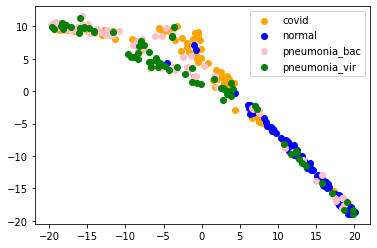

In [31]:
# TSNE dimension reduction 
# transfer learning from model and use TSNE to see how well they are separated
# in 2 dimension 
from sklearn.manifold import TSNE
from keras.models import Model
import pandas as pd

layer_name = 'dense_8'

intermediate_layer_model = Model(inputs=model.input,
                                 outputs=model.get_layer(layer_name).output)

tsne_data_generator = train_datagen.flow_from_directory(DATASET_PATH,target_size=IMAGE_SIZE,
                                                  batch_size=1,shuffle=False,seed=1,class_mode="categorical")

intermediate_output = intermediate_layer_model.predict(tsne_data_generator)

tsne = TSNE(n_components=2, verbose=1, random_state=42)
z = tsne.fit_transform(intermediate_output) 


# create a dictionary for the scatter plot
my_dictionary = {'x': z[:,0], 'y': z[:,1], 'classes': tsne_data_generator.classes}
df = pd.DataFrame(my_dictionary)

print(tsne_data_generator.class_indices)

c = ['orange', 'blue', 'pink', 'green']
for keys, values in tsne_data_generator.class_indices.items():
  plt.scatter(df[df.classes == values]['x'], df[df.classes == values]['y'], c=c[values], label = keys)

plt.legend()
plt.show()